# Description

This data was extracted from the 1994 Census bureau database by Ronny Kohavi and Barry Becker (Data Mining and Visualization, Silicon Graphics). A set of reasonably clean records was extracted using the following conditions: ((AAGE>16) && (AGI>100) && (AFNLWGT>1) && (HRSWK>0)). The prediction task is to determine whether a person makes over $50K a year.

Description of fnlwgt (final weight)

The weights on the Current Population Survey (CPS) files are controlled to independent estimates of the civilian non-institutional population of the US. These are prepared monthly for us by Population Division here at the Census Bureau. We use 3 sets of controls. These are:

    A single cell estimate of the population 16+ for each state.

    Controls for Hispanic Origin by age and sex.

    Controls by Race, age and sex.

We use all three sets of controls in our weighting program and "rake" through them 6 times so that by the end we come back to all the controls we used. The term estimate refers to population totals derived from CPS by creating "weighted tallies" of any specified socio-economic characteristics of the population. People with similar demographic characteristics should have similar weights. There is one important caveat to remember about this statement. That is that since the CPS sample is actually a collection of 51 state samples, each with its own probability of selection, the statement only applies within state.

Final Weight basically shows the population or the number of people a particular data row represents.

Apart from Final Weight we have 14 columns including Income(Target Variable) and 32560 rows. Each representing an individual's record.

We have to train a model which on the basis of given features can predict whether the person earns less than or equal to 50k or more than 50k.

As we only have two categories in our target variable we move ahead with Classification approach.

Lets Begin...!!!



In [1]:
# Importing Libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

In [2]:
# Importing Dataset into a Dataframe

inc_census=pd.read_csv('Income_Census.csv')

In [3]:
#to display complete data row and column wise

pd.set_option('display.max_rows',None)
pd.set_option('display.max_columns',None)

# Overview of the Data

In [ ]:
# Displaying first 10 Rows of Dataset

inc_census.head(10)

In [ ]:
inc_census.info()

In [7]:
inc_census.shape

(32560, 15)

In [8]:
inc_census.dtypes

Age                int64
Workclass         object
Fnlwgt             int64
Education         object
Education_num      int64
Marital_status    object
Occupation        object
Relationship      object
Race              object
Sex               object
Capital_gain       int64
Capital_loss       int64
Hours_per_week     int64
Native_country    object
Income            object
dtype: object

# Checking Null Values

In [10]:
inc_census.isnull().sum()

Age               0
Workclass         0
Fnlwgt            0
Education         0
Education_num     0
Marital_status    0
Occupation        0
Relationship      0
Race              0
Sex               0
Capital_gain      0
Capital_loss      0
Hours_per_week    0
Native_country    0
Income            0
dtype: int64

There are no null values present in the dataset. We will explore the dataset further to find any unusual entries.

# Exploring Categorical Columns

In [11]:
# We will check the value counts in the Categorical columns

for i in inc_census.columns:
    if inc_census[i].dtypes=='object':
        print(i)
        print(inc_census[i].value_counts(),'\n')
        print('---------------------------')

Workclass
 Private             22696
 Self-emp-not-inc     2541
 Local-gov            2093
 ?                    1836
 State-gov            1297
 Self-emp-inc         1116
 Federal-gov           960
 Without-pay            14
 Never-worked            7
Name: Workclass, dtype: int64 

---------------------------
Education
 HS-grad         10501
 Some-college     7291
 Bachelors        5354
 Masters          1723
 Assoc-voc        1382
 11th             1175
 Assoc-acdm       1067
 10th              933
 7th-8th           646
 Prof-school       576
 9th               514
 12th              433
 Doctorate         413
 5th-6th           333
 1st-4th           168
 Preschool          51
Name: Education, dtype: int64 

---------------------------
Marital_status
 Married-civ-spouse       14976
 Never-married            10682
 Divorced                  4443
 Separated                 1025
 Widowed                    993
 Married-spouse-absent      418
 Married-AF-spouse           23
Name: Mari

In [12]:
# Checking unique values in the categorical columns

for i in inc_census.columns:
    if inc_census[i].dtypes=='object':
        print(i)
        print(inc_census[i].unique(),'\n')
        print('---------------------------')

Workclass
[' Self-emp-not-inc' ' Private' ' State-gov' ' Federal-gov' ' Local-gov'
 ' ?' ' Self-emp-inc' ' Without-pay' ' Never-worked'] 

---------------------------
Education
[' Bachelors' ' HS-grad' ' 11th' ' Masters' ' 9th' ' Some-college'
 ' Assoc-acdm' ' Assoc-voc' ' 7th-8th' ' Doctorate' ' Prof-school'
 ' 5th-6th' ' 10th' ' 1st-4th' ' Preschool' ' 12th'] 

---------------------------
Marital_status
[' Married-civ-spouse' ' Divorced' ' Married-spouse-absent'
 ' Never-married' ' Separated' ' Married-AF-spouse' ' Widowed'] 

---------------------------
Occupation
[' Exec-managerial' ' Handlers-cleaners' ' Prof-specialty'
 ' Other-service' ' Adm-clerical' ' Sales' ' Craft-repair'
 ' Transport-moving' ' Farming-fishing' ' Machine-op-inspct'
 ' Tech-support' ' ?' ' Protective-serv' ' Armed-Forces'
 ' Priv-house-serv'] 

---------------------------
Relationship
[' Husband' ' Not-in-family' ' Wife' ' Own-child' ' Unmarried'
 ' Other-relative'] 

---------------------------
Race
[' White

We observe there are sum entries marked with " ?", These are the null values. They are present in Workclass, Occupation and Native_Country columns.

We fill these null values ahead.

In [27]:
# Checking Null value entries in workclass column
inc_census[inc_census.Workclass == (' ?')].head()

,Age,Workclass,Fnlwgt,Education,Education_num,Marital_status,Occupation,Relationship,Race,Sex,Capital_gain,Capital_loss,Hours_per_week,Native_country,Income
26,54,?,180211,Some-college,10,Married-civ-spouse,?,Husband,Asian-Pac-Islander,Male,0,0,60,South,>50K
60,32,?,293936,7th-8th,4,Married-spouse-absent,?,Not-in-family,White,Male,0,0,40,?,<=50K
68,25,?,200681,Some-college,10,Never-married,?,Own-child,White,Male,0,0,40,United-States,<=50K
76,67,?,212759,10th,6,Married-civ-spouse,?,Husband,White,Male,0,0,2,United-States,<=50K
105,17,?,304873,10th,6,Never-married,?,Own-child,White,Female,34095,0,32,United-States,<=50K


In [28]:
# # Checking Null value entries in Occupation column

inc_census[inc_census.Occupation == (' ?')].head()

,Age,Workclass,Fnlwgt,Education,Education_num,Marital_status,Occupation,Relationship,Race,Sex,Capital_gain,Capital_loss,Hours_per_week,Native_country,Income
26,54,?,180211,Some-college,10,Married-civ-spouse,?,Husband,Asian-Pac-Islander,Male,0,0,60,South,>50K
60,32,?,293936,7th-8th,4,Married-spouse-absent,?,Not-in-family,White,Male,0,0,40,?,<=50K
68,25,?,200681,Some-college,10,Never-married,?,Own-child,White,Male,0,0,40,United-States,<=50K
76,67,?,212759,10th,6,Married-civ-spouse,?,Husband,White,Male,0,0,2,United-States,<=50K
105,17,?,304873,10th,6,Never-married,?,Own-child,White,Female,34095,0,32,United-States,<=50K


In [ ]:
# Visualizing count of Categorical Columns

for i in inc_census.columns:
    if inc_census[i].dtypes=='object':
        plt.figure(figsize=(10,8))
        sns.countplot(inc_census[i])
        plt.title(i)
        plt.xticks(rotation=90)
        plt.show()

Observations

1. 69.7% of the population works in a private organization. 
2. 32.2% of people are only HS-graduate. While 22.3% are in some college and only 16.4% are Bachelor degree holders. Master degree holders have a way reduced count at only 5.2%.
3. 45% of people are married and have a civilian spouse. 32.8% are never married. 
4. Occupation has a uniform kind of distribution. The top 6 occupations have an almost similar distribution which is Prof-Speciality, Craft Repair, Exec-Managerial, Adm-Clerical, Sales, and Other Services. 
5. 85% of the people are White. 
6. We have a majority of records for males which are at 66% while female presence in the records is only 33%.
7. 89.5% of people belong to The United States alone. 1.7% are null values while only  8.8% are from other parts of the earth.
8. For the Income column (Target Variable) we have 75.9% of people with an income of less than or equal to 50k while only 24.1% earns more than that.

# Exploring Numerical Columns

In [11]:
# Dropping Fnlwgt column. As it represents the population for that particular entry it isn't a contributing feature to predict income of a person.

inc_census.drop(['Fnlwgt'],axis=1,inplace=True)

In [12]:
# Checking Numerical values for any abnormal entries.

for i in inc_census.columns:
    if inc_census[i].dtypes=='int64':
        print(i)
        print(inc_census[i].unique(),'\n')
        print('---------------------------')

Age
[50 38 53 28 37 49 52 31 42 30 23 32 40 34 25 43 54 35 59 56 19 39 20 45
 22 48 21 24 57 44 41 29 18 47 46 36 79 27 67 33 76 17 55 61 70 64 71 68
 66 51 58 26 60 90 75 65 77 62 63 80 72 74 69 73 81 78 88 82 83 84 85 86
 87] 

---------------------------
Education_num
[13  9  7 14  5 10 12 11  4 16 15  3  6  2  1  8] 

---------------------------
Capital_gain
[    0 14084  5178  5013  2407 14344 15024  7688 34095  4064  4386  7298
  1409  3674  1055  3464  2050  2176  2174   594 20051  6849  4101  1111
  8614  3411  2597 25236  4650  9386  2463  3103 10605  2964  3325  2580
  3471  4865 99999  6514  1471  2329  2105  2885 25124 10520  2202  2961
 27828  6767  2228  1506 13550  2635  5556  4787  3781  3137  3818  3942
   914   401  2829  2977  4934  2062  2354  5455 15020  1424  3273 22040
  4416  3908 10566   991  4931  1086  7430  6497   114  7896  2346  3418
  3432  2907  1151  2414  2290 15831 41310  4508  2538  3456  6418  1848
  3887  5721  9562  1455  2036  1831 11678  2936  2

In [ ]:
for i in inc_census.columns:
    if inc_census[i].dtypes=='int64':
        plt.figure(figsize=(10,8))
        plt.hist(inc_census[i],bins=30)
        plt.title(i)
        plt.xticks(rotation=90)
        plt.show()

Observation

1. Majority of people are in the age group 25-45yrs.
2. Around 48% people work for 40 hours a week.

# Bivariate Analysis

In [ ]:
plt.figure(figsize=(12,8))
sns.catplot(x='Income',y='Age', data=inc_census,kind='violin')
plt.show()

People who earn less than 50k falls majorly between age group 25 to 45 while those who earn more than 50k are between 35 to 55.

This could reflect the importance of experience and proficiency for the working people towards their income.

In [ ]:
plt.figure(figsize=(15,12))
sns.countplot(x='Workclass',hue='Income', data=inc_census)
plt.xticks(rotation=90)
plt.show()

In [ ]:
plt.figure(figsize=(15,12))
sns.boxplot(x='Workclass',y='Age',hue='Income', data=inc_census)
plt.xticks(rotation=90)
plt.show()

We have maximum employees in private organisation but also we see that people earning less than 50k are maximum in Private. This could possibly reflect less pay scale in private organization.

Also a majority of Private employees between age 25 to 45 earn less than 50k and those who earn more than 50k are between 35 to 50. 

For self employed small business owner usually falling between 35 to 55 earns less than 50k while more than 50k group fall between 38 to 55. There isnt much difference seen in terms of small business owners.

In [ ]:
plt.figure(figsize=(15,12))
sns.boxenplot(x='Occupation',y='Age',hue='Income', data=inc_census)
plt.xticks(rotation=90)
plt.show()

In [ ]:
plt.figure(figsize=(15,12))
sns.countplot(x='Education',hue='Income', data=inc_census)
plt.xticks(rotation=90)
plt.show()

We see that as we have majority of people HS Graduate we do see a high percentage of people earning less than 50k.

This is similar for College attendees.

On the other hand In People who are Graduate show higher percentage of people earning more than 50k. Even Post Graduates have higher percentage of people earning more than 50k.

This shows that level of education has a high impact on earning.

In [ ]:
plt.figure(figsize=(15,12))
sns.countplot(x='Marital_status',hue='Income', data=inc_census)
plt.xticks(rotation=90)
plt.show()

People who are married and hace civilian spouse show higher percentage of those who earns more than 50k. While thos who are never marriend show a way high percentage in less than 50k earning. 

This could be possibly because of the organised and responsible approach towards life and family afer marriage. 

This could also reflect in other way that succeddful people with good income are more likely to get married.

# Treating Null Values

As we observe in the exploration above:
1. For Workclass, we have 69.7% people working in the Private Sector. Therefore, probability of people having no Workclass record to be working in private is high. Thus, we will replace null values with 'Private'.
2. For Occupation there is no major count for a particular occupation. Thus we will replace the null values here with 'Unknown'.
3. For Native Country, United States has 89.5% share. Thus it is suitable to assume that the null values can be replaced with 'United-States'

In [67]:
inc_census['Workclass']=inc_census['Workclass'].replace(' ?','Private')
inc_census['Occupation']=inc_census['Occupation'].replace(' ?','Unknown')
inc_census['Native_country']=inc_census['Native_country'].replace(' ?','United-States')

# Statistical Analysis

In [68]:
inc_census.describe()

,Age,Education_num,Capital_gain,Capital_loss,Hours_per_week
count,32560.000000,32560.000000,32560.000000,32560.000000,32560.000000
mean,38.581634,10.080590,1077.615172,87.306511,40.437469
std,13.640642,2.572709,7385.402999,402.966116,12.347618
min,17.000000,1.000000,0.000000,0.000000,1.000000
25%,28.000000,9.000000,0.000000,0.000000,40.000000
50%,37.000000,10.000000,0.000000,0.000000,40.000000
75%,48.000000,12.000000,0.000000,0.000000,45.000000
max,90.000000,16.000000,99999.000000,4356.000000,99.000000


# Correlation

In [70]:
# Using Ordinal Encoder for changing string values in Income column to include in corrrelation matrix
from sklearn.preprocessing import OrdinalEncoder

In [73]:
oe=OrdinalEncoder()
inc_census['Income']=oe.fit_transform(inc_census['Income'].values.reshape(-1,1))

In [74]:
inc_census_cor=inc_census.corr()
inc_census_cor

,Age,Education_num,Capital_gain,Capital_loss,Hours_per_week,Income
Age,1.000000,0.036527,0.077674,0.057775,0.068756,0.234039
Education_num,0.036527,1.000000,0.122627,0.079932,0.148127,0.335182
Capital_gain,0.077674,0.122627,1.000000,-0.031614,0.078409,0.223333
Capital_loss,0.057775,0.079932,-0.031614,1.000000,0.054256,0.150523
Hours_per_week,0.068756,0.148127,0.078409,0.054256,1.000000,0.229690
Income,0.234039,0.335182,0.223333,0.150523,0.229690,1.000000


In [ ]:
# Plotting Heat Map for correlation

plt.figure(figsize=(10,8))
plt.title('Census Income Correlation')
sns.heatmap(inc_census_cor,annot=True)
plt.show

We certainly see some positive correlation between Age and Income. Hours per week do have similar correlation as working may result in higher earnings.

# Checking Outliers

In [ ]:
inc_census.boxplot(figsize=[18,10])
plt.subplots_adjust(bottom=0.25)
plt.show()

In [ ]:
We do observe some otliers in Capital Gain Column. We will try to remove them and see the impact on data.

In [99]:
#Making a copy of dataset to checque the impact of outlier removal

inc_census1=inc_census.copy()

In [100]:
# Using IQR method

q3=inc_census1['Capital_gain'].quantile(0.75)
q1=inc_census1['Capital_gain'].quantile(0.25)
iqr=q3-q1
ub=q3+1.5*iqr
lb=q1-1.5*iqr
inc_census1=inc_census1[~((inc_census1['Capital_gain'] < lb) | (inc_census1['Capital_gain'] > ub))]

In [104]:
inc_census1.shape

(29849, 14)

In [105]:
inc_census1.Capital_gain.unique()

array([0], dtype=int64)

In [106]:
# Using Z Score method

#Importing Zscore from Scipy
from scipy.stats import zscore

#Making a copy of dataset to checque the impact of outlier removal

inc_census1=inc_census.copy()

In [107]:
oe=OrdinalEncoder()
for i in inc_census1.columns:
    if inc_census1[i].dtypes=='object':
        inc_census1[i]=oe.fit_transform(inc_census1[i].values.reshape(-1,1))

In [108]:
#Evaluating ZScore
z=np.abs(zscore(inc_census1))
z

array([[0.83709708, 1.02638429, 0.33544266, ..., 2.22212013, 0.25138175,
        0.5632099 ],
       [0.04264043, 0.23786147, 0.18131885, ..., 0.03542999, 0.25138175,
        0.5632099 ],
       [1.05703146, 0.23786147, 2.40248871, ..., 0.03542999, 0.25138175,
        0.5632099 ],
       ...,
       [1.42358875, 0.23786147, 0.18131885, ..., 0.03542999, 0.25138175,
        0.5632099 ],
       [1.21562378, 0.23786147, 0.18131885, ..., 1.65520046, 0.25138175,
        0.5632099 ],
       [0.98372   , 0.39426141, 0.18131885, ..., 0.03542999, 0.25138175,
        1.77553698]])

In [86]:
threshold=3
print(np.where(z>3))

(array([    3,     9,    10, ..., 32532, 32550, 32552], dtype=int64), array([12, 11,  7, ...,  7,  7,  7], dtype=int64))


In [110]:
inc_census1_new=inc_census1[(z<3).all(axis=1)]
inc_census1_new.shape

(28094, 14)

# Loss Percentage

In [90]:
# For IQR

(32560-29849)/32560*100

8.326167076167076

In [91]:
# For Z-Score

(32560-28094)/32560*100

13.716216216216214

In both methods we observe high data loss. Using IQR wipes the data completely. Also the removed records in Z SCore might reflect true Capital Gain Income. Thus we will skip outlier removal and try to minimize outliers while correcting skewness.

# Checking Skewness

In [113]:
inc_census.skew().sort_values(ascending=False)

Capital_gain      11.953690
Capital_loss       4.594549
Income             1.212383
Age                0.558738
Hours_per_week     0.227636
Education_num     -0.311630
dtype: float64

In [ ]:
for j in inc_census.columns:
    if inc_census[j].dtypes=='int64':
        plt.figure(figsize=(10,8))
        sns.displot(inc_census[j],kde=True,bins=20)
        plt.title(j)
        plt.show()

High skewness in capital gain and Capital Loss. We will try to minimize skewness using power transform

# Skewness Correction

In [116]:
from sklearn.preprocessing import power_transform

inc_census['Capital_gain']=power_transform(inc_census['Capital_gain'].values.reshape(-1,1))
inc_census['Capital_loss']=power_transform(inc_census['Capital_loss'].values.reshape(-1,1))

In [117]:
inc_census.skew().sort_values(ascending=False)

Capital_loss      4.299511
Capital_gain      3.016951
Income            1.212383
Age               0.558738
Hours_per_week    0.227636
Education_num    -0.311630
dtype: float64

# Encoding

In [118]:
# Using Ordinal Encoder for changing remaining String Data values to numeric form
from sklearn.preprocessing import OrdinalEncoder

In [119]:
oe=OrdinalEncoder()
for i in inc_census1.columns:
    if inc_census1[i].dtypes=='object':
        inc_census1[i]=oe.fit_transform(inc_census1[i].values.reshape(-1,1))

# Splitting Input Features and Target Variable

In [120]:
x=inc_census1.drop(['Income'],axis=1)
y=inc_census1['Income']
print(x.head())
print(y.head())
print(x.shape)
print(y.shape)

   Age  Workclass  Education  Education_num  Marital_status  Occupation  \
0   50        5.0        9.0             13             2.0         3.0   
1   38        3.0       11.0              9             0.0         5.0   
2   53        3.0        1.0              7             2.0         5.0   
3   28        3.0        9.0             13             2.0         9.0   
4   37        3.0       12.0             14             2.0         3.0   

   Relationship  Race  Sex  Capital_gain  Capital_loss  Hours_per_week  \
0           0.0   4.0  1.0      -0.30137     -0.221213              13   
1           1.0   4.0  1.0      -0.30137     -0.221213              40   
2           0.0   2.0  1.0      -0.30137     -0.221213              40   
3           5.0   2.0  0.0      -0.30137     -0.221213              40   
4           5.0   4.0  0.0      -0.30137     -0.221213              40   

   Native_country  
0            38.0  
1            38.0  
2            38.0  
3             4.0  
4   

# Scaling

In [121]:
# As our target variable is having values 0 and 1 we will scale rest of the data between 0 and 1 using MinMax Scaler to train our model better

from sklearn.preprocessing import MinMaxScaler
mms=MinMaxScaler()

In [122]:
x_new=mms.fit_transform(x)
x=pd.DataFrame(x_new,columns=x.columns)
x

,Age,Workclass,Education,Education_num,Marital_status,Occupation,Relationship,Race,Sex,Capital_gain,Capital_loss,Hours_per_week,Native_country
0,0.452055,0.625,0.600000,0.800000,0.333333,0.214286,0.0,1.00,1.0,0.000000,0.000000,0.122449,0.926829
1,0.287671,0.375,0.733333,0.533333,0.000000,0.357143,0.2,1.00,1.0,0.000000,0.000000,0.397959,0.926829
2,0.493151,0.375,0.066667,0.400000,0.333333,0.357143,0.0,0.50,1.0,0.000000,0.000000,0.397959,0.926829
3,0.150685,0.375,0.600000,0.800000,0.333333,0.642857,1.0,0.50,0.0,0.000000,0.000000,0.397959,0.097561
4,0.273973,0.375,0.800000,0.866667,0.333333,0.214286,1.0,1.00,0.0,0.000000,0.000000,0.397959,0.926829
5,0.438356,0.375,0.400000,0.266667,0.500000,0.500000,0.2,0.50,0.0,0.000000,0.000000,0.153061,0.536585
6,0.479452,0.625,0.733333,0.533333,0.333333,0.214286,0.0,1.00,1.0,0.000000,0.000000,0.448980,0.926829
7,0.191781,0.375,0.800000,0.866667,0.666667,0.642857,0.2,1.00,0.0,0.999998,0.000000,0.500000,0.926829
8,0.342466,0.375,0.600000,0.800000,0.333333,0.214286,0.0,1.00,1.0,0.999991,0.000000,0.397959,0.926829
9,0.273973,0.375,1.000000,0.600000,0.333333,0.214286,0.0,0.50,1.0,0.000000,0.000000,0.806122,0.926829


In [124]:
# Importing Algortihms and Metrics and Finding Best Random State

In [125]:
# Importing Classification Algorithms
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import RandomForestClassifier,GradientBoostingClassifier,AdaBoostClassifier
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score,confusion_matrix,classification_report

In [126]:
maxAccu=0
maxRs=0
for i in range(1,500):
    x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=.33,random_state=i)
    lr=LogisticRegression()
    lr.fit(x_train,y_train)
    lrpred=lr.predict(x_test)
    acc=accuracy_score(y_test,lrpred)
    if acc>maxAccu:
        maxAccu=acc
        maxRs=i
print('Best Accuracy Score is : ', maxAccu, ' when Random state is : ',maxRs)

Best Accuracy Score is :  0.826058631921824  when Random state is :  448


In [241]:
# Using Random State 448

x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=.33,random_state=448)

In [127]:
# Defining Model List
model_list=[LogisticRegression(),SVC(),DecisionTreeClassifier(),KNeighborsClassifier(),RandomForestClassifier(),GradientBoostingClassifier(),AdaBoostClassifier(),GaussianNB(),XGBClassifier()]

In [254]:
# Creating For loop to print Training and Test accuracy score
for m in model_list:
    model=m
    model.fit(x_train,y_train)
    model_pred_train=model.predict(x_train)
    model_pred=model.predict(x_test)
    print('Training Accuracy for the model ',m,' is: ',accuracy_score(y_train,model_pred_train)*100)
    print('Testing Accuracy for the model ',m,' is: ',accuracy_score(y_test,model_pred)*100)
    print('\n')
    

Training Accuracy for the model  LogisticRegression()  is:  81.00389640155856
Testing Accuracy for the model  LogisticRegression()  is:  82.60586319218241


Training Accuracy for the model  SVC()  is:  83.60302544121018
Testing Accuracy for the model  SVC()  is:  84.40204746393671


Training Accuracy for the model  DecisionTreeClassifier()  is:  97.93261517304607
Testing Accuracy for the model  DecisionTreeClassifier()  is:  80.95858538855282


Training Accuracy for the model  KNeighborsClassifier()  is:  87.35732294292917
Testing Accuracy for the model  KNeighborsClassifier()  is:  82.7826896230805


Training Accuracy for the model  RandomForestClassifier()  is:  97.92344716937886
Testing Accuracy for the model  RandomForestClassifier()  is:  84.64402047463938


Training Accuracy for the model  GradientBoostingClassifier()  is:  86.13339445335778
Testing Accuracy for the model  GradientBoostingClassifier()  is:  86.66356444858073


Training Accuracy for the model  AdaBoostClassifier()

# Cross Validation

In [244]:
from sklearn.model_selection import cross_val_score

In [245]:
# Logistic Regression
lr=LogisticRegression()
lr.fit(x_train,y_train)
lr_pred=lr.predict(x_test)
testing_accu=accuracy_score(y_test,lr_pred)*100
for k in range(2,10):
    cv_score=cross_val_score(LogisticRegression(),x,y,cv=k)
    cv_mean=cv_score.mean()*100
    print(f'At crossfold {k} the CV score of is {cv_mean} and the accuracy for testing is {testing_accu} ')
    print('\n')

At crossfold 2 the CV score of is 81.52334152334153 and the accuracy for testing is 82.60586319218241 


At crossfold 3 the CV score of is 81.54484988097722 and the accuracy for testing is 82.60586319218241 


At crossfold 4 the CV score of is 81.5448402948403 and the accuracy for testing is 82.60586319218241 


At crossfold 5 the CV score of is 81.52027027027027 and the accuracy for testing is 82.60586319218241 


At crossfold 6 the CV score of is 81.51720906554675 and the accuracy for testing is 82.60586319218241 


At crossfold 7 the CV score of is 81.55712802238952 and the accuracy for testing is 82.60586319218241 


At crossfold 8 the CV score of is 81.55405405405406 and the accuracy for testing is 82.60586319218241 


At crossfold 9 the CV score of is 81.5632667206977 and the accuracy for testing is 82.60586319218241 




In [246]:
# SVC
svc=SVC()
svc.fit(x_train,y_train)
svc_pred=svc.predict(x_test)
testing_accu=accuracy_score(y_test,svc_pred)*100
for k in range(2,10):
    cv_score=cross_val_score(svc,x,y,cv=k)
    cv_mean=cv_score.mean()*100
    print(f'At crossfold {k} the CV score of is {cv_mean} and the accuracy for testing is {testing_accu} ')
    print('\n')

At crossfold 2 the CV score of is 83.4029484029484 and the accuracy for testing is 84.40204746393671 


At crossfold 3 the CV score of is 83.6056639969827 and the accuracy for testing is 84.40204746393671 


At crossfold 4 the CV score of is 83.53194103194103 and the accuracy for testing is 84.40204746393671 


At crossfold 5 the CV score of is 83.58722358722359 and the accuracy for testing is 84.40204746393671 


At crossfold 6 the CV score of is 83.59338785451862 and the accuracy for testing is 84.40204746393671 


At crossfold 7 the CV score of is 83.63639882229437 and the accuracy for testing is 84.40204746393671 


At crossfold 8 the CV score of is 83.66707616707617 and the accuracy for testing is 84.40204746393671 


At crossfold 9 the CV score of is 83.694711946298 and the accuracy for testing is 84.40204746393671 




In [247]:
# DecisionTreeClassifier
dtc=DecisionTreeClassifier()
dtc.fit(x_train,y_train)
dtc_pred=dtc.predict(x_test)
testing_accu=accuracy_score(y_test,dtc_pred)*100
for k in range(2,10):
    cv_score=cross_val_score(dtc,x,y,cv=k)
    cv_mean=cv_score.mean()*100
    print(f'At crossfold {k} the CV score of is {cv_mean} and the accuracy for testing is {testing_accu} ')
    print('\n')

At crossfold 2 the CV score of is 80.57125307125307 and the accuracy for testing is 81.23778501628665 


At crossfold 3 the CV score of is 80.61119309576951 and the accuracy for testing is 81.23778501628665 


At crossfold 4 the CV score of is 80.87223587223588 and the accuracy for testing is 81.23778501628665 


At crossfold 5 the CV score of is 80.51597051597051 and the accuracy for testing is 81.23778501628665 


At crossfold 6 the CV score of is 80.6849166453345 and the accuracy for testing is 81.23778501628665 


At crossfold 7 the CV score of is 80.78934832489438 and the accuracy for testing is 81.23778501628665 


At crossfold 8 the CV score of is 80.78931203931204 and the accuracy for testing is 81.23778501628665 


At crossfold 9 the CV score of is 80.61730925272401 and the accuracy for testing is 81.23778501628665 




In [248]:
# KNeighborsClassifier
knn=KNeighborsClassifier()
knn.fit(x_train,y_train)
knn_pred=knn.predict(x_test)
testing_accu=accuracy_score(y_test,knn_pred)*100
for k in range(2,10):
    cv_score=cross_val_score(knn,x,y,cv=k)
    cv_mean=cv_score.mean()*100
    print(f'At crossfold {k} the CV score of is {cv_mean} and the accuracy for testing is {testing_accu} ')
    print('\n')

At crossfold 2 the CV score of is 82.61363636363637 and the accuracy for testing is 82.7826896230805 


At crossfold 3 the CV score of is 82.76413490016533 and the accuracy for testing is 82.7826896230805 


At crossfold 4 the CV score of is 82.55528255528256 and the accuracy for testing is 82.7826896230805 


At crossfold 5 the CV score of is 82.60749385749385 and the accuracy for testing is 82.7826896230805 


At crossfold 6 the CV score of is 82.65358270965142 and the accuracy for testing is 82.7826896230805 


At crossfold 7 the CV score of is 82.53075411809662 and the accuracy for testing is 82.7826896230805 


At crossfold 8 the CV score of is 82.5522113022113 and the accuracy for testing is 82.7826896230805 


At crossfold 9 the CV score of is 82.5952173889934 and the accuracy for testing is 82.7826896230805 




# Ensemble Techniques

In [249]:
# RandomForestClassifier
rfc=RandomForestClassifier()
rfc.fit(x_train,y_train)
rfc_pred=rfc.predict(x_test)
testing_accu=accuracy_score(y_test,rfc_pred)*100
for k in range(2,10):
    cv_score=cross_val_score(rfc,x,y,cv=k)
    cv_mean=cv_score.mean()*100
    print(f'At crossfold {k} the CV score of is {cv_mean} and the accuracy for testing is {testing_accu} ')
    print('\n')

At crossfold 2 the CV score of is 84.3519656019656 and the accuracy for testing is 84.65332712889716 


At crossfold 3 the CV score of is 84.45332786546342 and the accuracy for testing is 84.65332712889716 


At crossfold 4 the CV score of is 84.52395577395578 and the accuracy for testing is 84.65332712889716 


At crossfold 5 the CV score of is 84.42874692874692 and the accuracy for testing is 84.65332712889716 


At crossfold 6 the CV score of is 84.5669724441641 and the accuracy for testing is 84.65332712889716 


At crossfold 7 the CV score of is 84.32434763333656 and the accuracy for testing is 84.65332712889716 


At crossfold 8 the CV score of is 84.44103194103194 and the accuracy for testing is 84.65332712889716 


At crossfold 9 the CV score of is 84.25063149558359 and the accuracy for testing is 84.65332712889716 




In [255]:
# Gradient Boosting Classifier

gbc=GradientBoostingClassifier()
gbc.fit(x_train,y_train)
gbc_pred=gbc.predict(x_test)
testing_accu=accuracy_score(y_test,gbc_pred)*100
for k in range(2,10):
    cv_score=cross_val_score(gbc,x,y,cv=k)
    cv_mean=cv_score.mean()*100
    print(f'At crossfold {k} the CV score of is {cv_mean} and the accuracy for testing is {testing_accu} ')
    print('\n')

At crossfold 2 the CV score of is 86.01965601965603 and the accuracy for testing is 86.66356444858073 


At crossfold 3 the CV score of is 86.05344326708328 and the accuracy for testing is 86.66356444858073 


At crossfold 4 the CV score of is 85.97972972972973 and the accuracy for testing is 86.66356444858073 


At crossfold 5 the CV score of is 86.02272727272728 and the accuracy for testing is 86.66356444858073 


At crossfold 6 the CV score of is 86.0104587572574 and the accuracy for testing is 86.66356444858073 


At crossfold 7 the CV score of is 85.93061640341296 and the accuracy for testing is 86.66356444858073 


At crossfold 8 the CV score of is 85.99508599508599 and the accuracy for testing is 86.66356444858073 


At crossfold 9 the CV score of is 86.01044735873771 and the accuracy for testing is 86.66356444858073 




In [250]:
# AdaBoostClassifier

adb=AdaBoostClassifier()
adb.fit(x_train,y_train)
adb_pred=adb.predict(x_test)
testing_accu=accuracy_score(y_test,adb_pred)*100
for k in range(2,10):
    cv_score=cross_val_score(adb,x,y,cv=k)
    cv_mean=cv_score.mean()*100
    print(f'At crossfold {k} the CV score of is {cv_mean} and the accuracy for testing is {testing_accu} ')
    print('\n')

At crossfold 2 the CV score of is 85.62653562653563 and the accuracy for testing is 86.24476500697999 


At crossfold 3 the CV score of is 85.7371134438071 and the accuracy for testing is 86.24476500697999 


At crossfold 4 the CV score of is 85.57739557739559 and the accuracy for testing is 86.24476500697999 


At crossfold 5 the CV score of is 85.66646191646193 and the accuracy for testing is 86.24476500697999 


At crossfold 6 the CV score of is 85.58663771602642 and the accuracy for testing is 86.24476500697999 


At crossfold 7 the CV score of is 85.69721201450747 and the accuracy for testing is 86.24476500697999 


At crossfold 8 the CV score of is 85.68181818181819 and the accuracy for testing is 86.24476500697999 


At crossfold 9 the CV score of is 85.63269454683731 and the accuracy for testing is 86.24476500697999 




# Naive-Bayes

In [251]:
# GaussianNB

gnb=GaussianNB()
gnb.fit(x_train,y_train)
gnb_pred=gnb.predict(x_test)
testing_accu=accuracy_score(y_test,gnb_pred)*100
for k in range(2,10):
    cv_score=cross_val_score(gnb,x,y,cv=k)
    cv_mean=cv_score.mean()*100
    print(f'At crossfold {k} the CV score of is {cv_mean} and the accuracy for testing is {testing_accu} ')
    print('\n')

At crossfold 2 the CV score of is 80.78316953316953 and the accuracy for testing is 81.4611447184737 


At crossfold 3 the CV score of is 80.84767750759485 and the accuracy for testing is 81.4611447184737 


At crossfold 4 the CV score of is 80.82309582309583 and the accuracy for testing is 81.4611447184737 


At crossfold 5 the CV score of is 80.83538083538085 and the accuracy for testing is 81.4611447184737 


At crossfold 6 the CV score of is 80.81083877686012 and the accuracy for testing is 81.4611447184737 


At crossfold 7 the CV score of is 80.80163446919512 and the accuracy for testing is 81.4611447184737 


At crossfold 8 the CV score of is 80.8046683046683 and the accuracy for testing is 81.4611447184737 


At crossfold 9 the CV score of is 80.81696834674183 and the accuracy for testing is 81.4611447184737 




# XG Boost Classifier

In [252]:
# XGBClassifier

xgb=XGBClassifier()
xgb.fit(x_train,y_train)
xgb_pred=xgb.predict(x_test)
testing_accu=accuracy_score(y_test,xgb_pred)*100
for k in range(2,10):
    cv_score=cross_val_score(xgb,x,y,cv=k)
    cv_mean=cv_score.mean()*100
    print(f'At crossfold {k} the CV score of is {cv_mean} and the accuracy for testing is {testing_accu} ')
    print('\n')

[03:47:24] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.3.0/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[03:47:24] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.3.0/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[03:47:24] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.3.0/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
At crossfold 2 the CV score of is 86.30221130221129 and the accuracy f

[03:47:31] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.3.0/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[03:47:31] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.3.0/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[03:47:31] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.3.0/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
At crossfold 7 the CV score of is 86.49265204321459 and the accuracy f

As we observe, there is very similar performance accuracy with Random Forest and KNeighbors Classifier. We further Hyper tune both models and see if we can achieve any improvement in accuracy.

# Hyper Parameter Tuning

In [256]:
#Importing GridearchCV

from sklearn.model_selection import GridSearchCV

For Random Forest Classifier

In [258]:
# defining parameters for Random Forest


gr_param={'n_estimators':list(range(50,400,50)),'max_depth' : np.arange(2,15),'criterion':['gini','entropy'],'max_features':['auto', 'sqrt', 'log2']}
gcv= GridSearchCV(estimator=rfc,param_grid=gr_param,scoring='accuracy',cv=5)

In [259]:
# Getting Best Parameters for Random Forest

gcv.fit(x_train,y_train)
gcv.best_params_

{'criterion': 'gini',
 'max_depth': 14,
 'max_features': 'sqrt',
 'n_estimators': 150}

In [262]:
# Trainig model with Random Forest Algorithm with best parameters and cross validating.

rfc1=RandomForestClassifier(criterion='gini',max_depth=14,max_features='sqrt',n_estimators=150)
rfc1.fit(x_train,y_train)
rfc1_pred=rfc1.predict(x_test)
testing_accu=accuracy_score(y_test,rfc1_pred)*100
for k in range(2,10):
    cv_score=cross_val_score(rfc1,x,y,cv=k)
    cv_mean=cv_score.mean()*100
    print(f'At crossfold {k} the CV score of is {cv_mean} and the accuracy for testing is {testing_accu} ')
    print('\n')

At crossfold 2 the CV score of is 85.69717444717443 and the accuracy for testing is 86.66356444858073 


At crossfold 3 the CV score of is 85.9520964430475 and the accuracy for testing is 86.66356444858073 


At crossfold 4 the CV score of is 85.89987714987714 and the accuracy for testing is 86.66356444858073 


At crossfold 5 the CV score of is 85.92751842751844 and the accuracy for testing is 86.66356444858073 


At crossfold 6 the CV score of is 85.97974641497657 and the accuracy for testing is 86.66356444858073 


At crossfold 7 the CV score of is 85.91218850748461 and the accuracy for testing is 86.66356444858073 


At crossfold 8 the CV score of is 85.97972972972974 and the accuracy for testing is 86.66356444858073 


At crossfold 9 the CV score of is 85.96743462636098 and the accuracy for testing is 86.66356444858073 




# Plotting AucRoc curve and checking Auc Score

In [269]:
from sklearn.metrics import roc_curve,roc_auc_score

In [270]:
y_pred_prob=rfc1.predict_proba(x_test)[:,1]
fpr,tpr,thresholds=roc_curve(y_test,y_pred_prob)

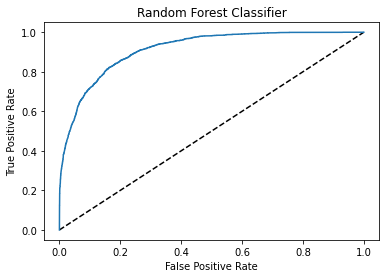

In [271]:
plt.plot([0,1],[0,1],'k--')
plt.plot(fpr,tpr,label='Random Forest Classifier')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Random Forest Classifier')
plt.show()

In [272]:
auc_score=roc_auc_score(y_test,y_pred_prob)*100
auc_score

91.33076678009405

for KNeighbors Classifier

In [265]:
# defining parameters for KNN


gr_param_knn={'n_neighbors':range(2,15),'weights':['uniform', 'distance'],'algorithm':['auto', 'ball_tree', 'kd_tree','brute']}
gcv_knn= GridSearchCV(estimator=knn,param_grid=gr_param_knn,scoring='accuracy',cv=5)

In [266]:
# Getting Best Parameters for KNN

gcv_knn.fit(x_train,y_train)
gcv_knn.best_params_

{'algorithm': 'auto', 'n_neighbors': 10, 'weights': 'uniform'}

In [268]:
# Trainig model with KNeighbors Algorithm with best parameters and cross validating.

knn1=KNeighborsClassifier(algorithm='auto',n_neighbors=10,weights='uniform')
knn1.fit(x_train,y_train)
knn1_pred=knn1.predict(x_test)
testing_accu=accuracy_score(y_test,knn1_pred)*100

for k in range(2,10):
    cv_score=cross_val_score(knn1,x,y,cv=k)
    cv_mean=cv_score.mean()*100
    print(f'At crossfold {k} the CV score of is {cv_mean} and the accuracy for testing is {testing_accu} ')
    print('\n')

At crossfold 2 the CV score of is 83.19717444717445 and the accuracy for testing is 83.85295486272685 


At crossfold 3 the CV score of is 83.40603122645184 and the accuracy for testing is 83.85295486272685 


At crossfold 4 the CV score of is 83.32923832923834 and the accuracy for testing is 83.85295486272685 


At crossfold 5 the CV score of is 83.3384520884521 and the accuracy for testing is 83.85295486272685 


At crossfold 6 the CV score of is 83.43368514623371 and the accuracy for testing is 83.85295486272685 


At crossfold 7 the CV score of is 83.5350486959956 and the accuracy for testing is 83.85295486272685 


At crossfold 8 the CV score of is 83.5995085995086 and the accuracy for testing is 83.85295486272685 


At crossfold 9 the CV score of is 83.5196706134387 and the accuracy for testing is 83.85295486272685 




# Plotting AucRoc curve and checking Auc Score

In [273]:
y_pred_prob=knn1.predict_proba(x_test)[:,1]
fpr,tpr,thresholds=roc_curve(y_test,y_pred_prob)

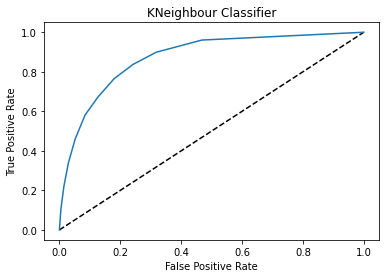

In [274]:
plt.plot([0,1],[0,1],'k--')
plt.plot(fpr,tpr,label='KNeighbour Classifier')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('KNeighbour Classifier')
plt.show()

In [275]:
auc_score=roc_auc_score(y_test,y_pred_prob)*100
auc_score

87.33349252967275

Random Forest provided us with better accuracy and performance. Also the Auc Score is better then KNN we will move ahead with Random Forest and train our model.

In [280]:
# Training final model with Random Forest and best possible parameters

rfc=RandomForestClassifier(criterion='gini',max_depth=14,max_features='sqrt',n_estimators=150)
rfc.fit(x_train,y_train)
rfc_pred=rfc.predict(x_test)

print('Accuracy Score of the model is : \n',accuracy_score(y_test,rfc_pred)*100,'\n')
print('Confusion Matrix is : \n',confusion_matrix(y_test,rfc_pred),'\n')
print('Classification Report is : \n',classification_report(y_test,rfc_pred),'\n')

Accuracy Score of the model is : 
 86.45881805490926 

Confusion Matrix is : 
 [[7752  512]
 [ 943 1538]] 

Classification Report is : 
               precision    recall  f1-score   support

           0       0.89      0.94      0.91      8264
           1       0.75      0.62      0.68      2481

    accuracy                           0.86     10745
   macro avg       0.82      0.78      0.80     10745
weighted avg       0.86      0.86      0.86     10745
 



# Saving the model

In [281]:
import pickle
filename='income_census.pkl'
pickle.dump(rfc,open(filename,'wb'))

# Conclusion

In [282]:
load_model=pickle.load(open('income_census.pkl','rb'))
result=load_model.score(x_test,y_test)
print(result)

0.8645881805490926


In [287]:
conclusion=pd.DataFrame([load_model.predict(x_test)[:],rfc_pred[:]],index=['Predicted','Original'])
conclusion

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,816,817,818,819,820,821,822,823,824,825,826,827,828,829,830,831,832,833,834,835,836,837,838,839,840,841,842,843,844,845,846,847,848,849,850,851,852,853,854,855,856,857,858,859,860,861,862,863,864,865,866,867,868,869,870,871,872,873,874,875,876,877,878,879,880,881,882,883,884,885,886,887,888,889,890,891,892,893,894,895,896,897,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,1000,1001,1002,1003,1004,1005,1006,1007,1008,1009,1010,1011,1012,1013,1014,1015,1016,1017,1018,1019,1020,1021